# Generative Adversarial Network

## Parameters

In [1]:
import torch
import numpy as np

np.random.seed(37)
torch.manual_seed(37)
torch.backends.cudnn.deterministic = True
torch.backends.cudnn.benchmark = False

device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
n_gpu = 1 # number of GPUs
n_c = 3 # number of classes
n_z = 100 # size of latent vector
n_gf = 64 # generator
n_df = 64 # discriminator
batch_size = 64 # batch size
beta1 = 0.5 # beta1 for adam
lr = 0.0002 # learning rate
n_iters = 25 # number of epochs
out_folder = './output' # output folder
image_size = 64 # image size
data_root = './output/cifar'

## Data

In [2]:
from torchvision import datasets, models, transforms
from torchvision.transforms import *
from torch.utils.data import DataLoader

def get_dataloaders(image_size=64, batch_size=4):
    def clean_up(path):
        import os
        from shutil import rmtree

        ipynb_checkpoints = f'{path}/.ipynb_checkpoints'
        if os.path.exists(ipynb_checkpoints):
            rmtree(ipynb_checkpoints)

    def get_dataloader(phase):
        path = f'./shapes/{phase}'
        clean_up(path)

        transform = transforms.Compose([
            Resize(image_size),
            CenterCrop(image_size),
            ToTensor(),
            Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
        ])

        image_folder = datasets.ImageFolder(path, transform=transform)
        
        return DataLoader(image_folder, batch_size=batch_size, shuffle=True, num_workers=4)

    return {phase: get_dataloader(phase) for phase in ['train', 'test', 'valid']}

def get_cifar(data_root, image_size=64, batch_size=4, num_workers=4):
    transform = transforms.Compose([
        Resize(image_size),
        ToTensor(),
        Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5))
    ])
    dataset = datasets.CIFAR10(root=data_root, download=True, transform=transform)
    dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=True, num_workers=num_workers)
    return dataloader

# dataloaders = get_dataloaders(image_size=image_size, batch_size=batch_size)
dataloader = get_cifar(data_root, image_size, batch_size)

Files already downloaded and verified


## Generator network

In [3]:
import torch.nn as nn

def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        m.weight.data.normal_(0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)


class Generator(nn.Module):
    def __init__(self, ngpu, nz, ngf, nc):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d(     nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d(ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d(ngf * 2,     ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d(    ngf,      nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)
        return output


netG = Generator(n_gpu, n_z, n_gf, n_c).to(device)
netG.apply(weights_init)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

## Discriminator

In [4]:
class Discriminator(nn.Module):
    def __init__(self, ngpu, ndf, nc):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        if input.is_cuda and self.ngpu > 1:
            output = nn.parallel.data_parallel(self.main, input, range(self.ngpu))
        else:
            output = self.main(input)

        return output.view(-1, 1).squeeze(1)


netD = Discriminator(n_gpu, n_df, n_c).to(device)
netD.apply(weights_init)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)

## Loss function and optimizer

In [5]:
import torch.optim as optim

criterion = nn.BCELoss()

fixed_noise = torch.randn(batch_size, n_z, 1, 1, device=device)
real_label = 1
fake_label = 0

# setup optimizer
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

In [6]:
import torchvision.utils as vutils
from collections import namedtuple

RESULT = namedtuple('RESULT', 'epoch i D G Dx DGz1 DGz2')
results = []
images = []
iters = 0

for epoch in range(n_iters):
    for i, data in enumerate(dataloader, 0):
        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        # train with real        
        netD.zero_grad()
        real_cpu = data[0].to(device);
        batch_size = real_cpu.size(0);
        label = torch.full((batch_size,), real_label, device=device);

        output = netD(real_cpu);
        errD_real = criterion(output, label)
        errD_real.backward()
        D_x = output.mean().item()

        # train with fake
        noise = torch.randn(batch_size, n_z, 1, 1, device=device)
        fake = netG(noise)
        label.fill_(fake_label)
        output = netD(fake.detach())
        errD_fake = criterion(output, label)
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        errD = errD_real + errD_fake
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        output = netD(fake)
        errG = criterion(output, label)
        errG.backward()
        D_G_z2 = output.mean().item()
        optimizerG.step()

        result = RESULT(epoch, i, errD.item(), errG.item(), D_x, D_G_z1, D_G_z2)
        results.append(result)
        
        if i % 50 == 0 and i != 0:
            s_iter = f'[{epoch}/{n_iters}][{i}/{len(dataloader)}]'
            s_loss = f'Loss_D {errD.item():.4f} Loss_G: {errG.item():.4f}'
            f_loss = f'D(x): {D_x:.4f} D(G(z)): {D_G_z1:.4f} / {D_G_z2:.4f}'
            print(f'{s_iter} {s_loss} {f_loss}')            
            
        if i % 100 == 0:
            s_epoch = str(epoch).zfill(3)
            f_path = f'{out_folder}/real_samples_epoch_{s_epoch}.png'
            vutils.save_image(real_cpu, f_path, normalize=True)
            
            f_path = f'{out_folder}/fake_samples_epoch_{s_epoch}.png'
            
            with torch.no_grad():
                fake = netG(fixed_noise)            
            vutils.save_image(fake.detach(), f_path, normalize=True)
            
            
        if (iters % 500 == 0) or ((epoch == n_iters -1) and (i == len(dataloader) - 1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            images.append(vutils.make_grid(fake, padding=2, normalize=True))
        
        iters += 1

[0/25][50/782] Loss_D 0.7834 Loss_G: 15.7248 D(x): 0.9287 D(G(z)): 0.4678 / 0.0000
[0/25][100/782] Loss_D 0.4271 Loss_G: 5.3906 D(x): 0.9323 D(G(z)): 0.2665 / 0.0080
[0/25][150/782] Loss_D 0.3438 Loss_G: 4.1836 D(x): 0.8240 D(G(z)): 0.0964 / 0.0353
[0/25][200/782] Loss_D 0.2067 Loss_G: 5.6477 D(x): 0.9412 D(G(z)): 0.1287 / 0.0053
[0/25][250/782] Loss_D 0.2138 Loss_G: 5.7386 D(x): 0.9344 D(G(z)): 0.1209 / 0.0044
[0/25][300/782] Loss_D 0.1902 Loss_G: 4.8060 D(x): 0.8888 D(G(z)): 0.0156 / 0.0154
[0/25][350/782] Loss_D 0.1072 Loss_G: 7.5507 D(x): 0.9394 D(G(z)): 0.0237 / 0.0060
[0/25][400/782] Loss_D 0.1532 Loss_G: 5.0835 D(x): 0.9484 D(G(z)): 0.0876 / 0.0111
[0/25][450/782] Loss_D 0.6046 Loss_G: 3.0891 D(x): 0.6569 D(G(z)): 0.0137 / 0.0736
[0/25][500/782] Loss_D 0.4401 Loss_G: 5.5217 D(x): 0.8637 D(G(z)): 0.2194 / 0.0053
[0/25][550/782] Loss_D 0.7421 Loss_G: 6.5020 D(x): 0.9843 D(G(z)): 0.4203 / 0.0037
[0/25][600/782] Loss_D 0.3080 Loss_G: 4.7863 D(x): 0.8827 D(G(z)): 0.1266 / 0.0159
[0/2

## Visualization

### Visualize loss

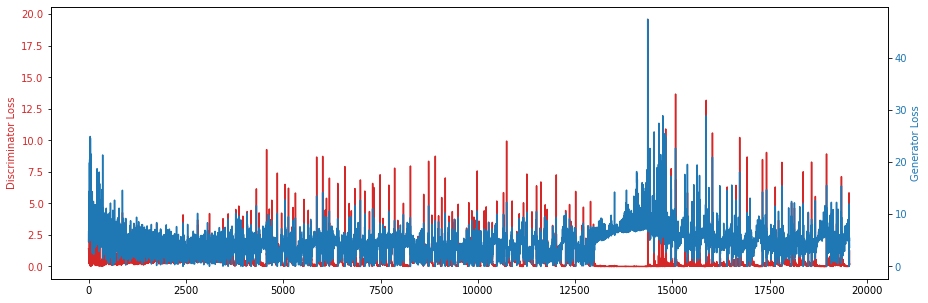

In [7]:
%matplotlib inline
import matplotlib.pyplot as plt

y1 = [r.D for r in results]
y2 = [r.G for r in results]
x = [i for i in range(len(y1))]

fig, ax1 = plt.subplots(figsize=(15, 5))
color = 'tab:red'
ax1.plot(x, y1, color=color)
ax1.set_ylabel('Discriminator Loss', color=color)
ax1.tick_params(axis='y', labelcolor=color)

ax2 = ax1.twinx()
color = 'tab:blue'
ax2.plot(x, y2, color=color)
ax2.set_ylabel('Generator Loss', color=color)
ax2.tick_params(axis='y', labelcolor=color)

### Visualize generator's progression

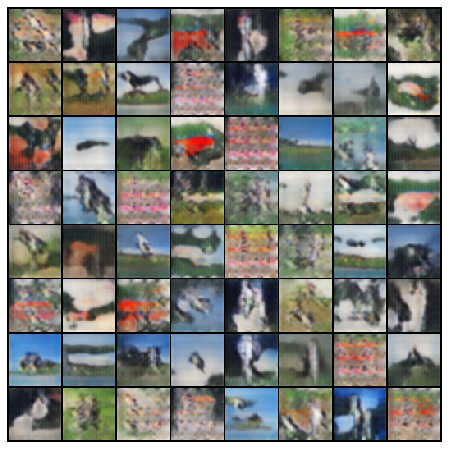

In [12]:
import matplotlib
import matplotlib.animation as animation
from IPython.display import HTML

matplotlib.rcParams['animation.embed_limit'] = 2**128

fig = plt.figure(figsize=(8,8))
plt.axis('off')
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in images]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

### Visualize real vs fake

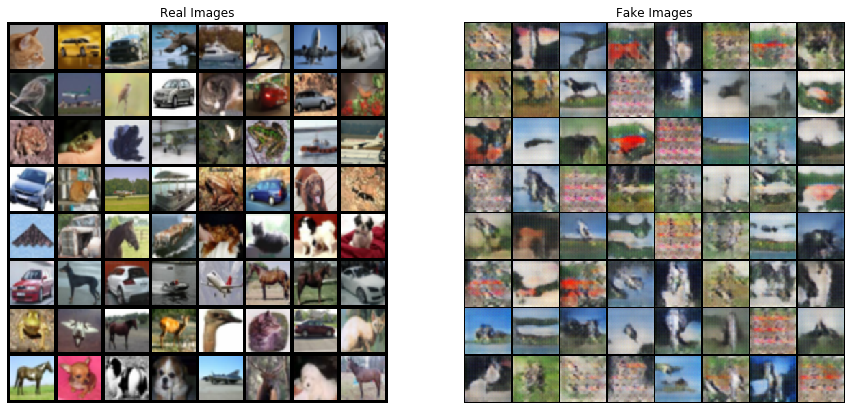

In [9]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(images[-1],(1,2,0)))
plt.show()

## Saving

In [10]:
s_epoch = str(epoch).zfill(3)

g_path = f'{out_folder}/netG_epoch_{s_epoch}.pth'
d_path = f'{out_folder}/netD_epoch_{s_epoch}.pth'

torch.save(netG.state_dict(), g_path)
torch.save(netD.state_dict(), d_path)